# CAPSTONE PROJECT-3 :- PRCP-1027- SKIN DISORDER CLASSIFICATION

# PROJECT TEAM ID :- PTID-CDS-AUG-23-1605

## Problem Statement

**Task 1:** -Prepare a complete data analysis report on the given data.

**Task 2:**-Create a predictive model  using machine learning techniques to predict the various classes of skin disease.

**Task3:**-Suggestions to the Doctors to identify the skin diseases of the patient at the earliest.

## Dataset Information:

* This database contains 34 attributes, 33 of which are linear valued and one of them is nominal.


* The differential diagnosis of erythemato-squamous diseases is a real problem in dermatology. They all share the clinical     features of erythema and scaling, with very little differences.


* The diseases in this group are **psoriasis**, **seboreic dermatitis**, **lichen planus**, **pityriasis rosea**, **cronic dermatitis**, and **pityriasis rubra pilaris**.


* Usually a biopsy is necessary for the diagnosis but unfortunately these diseases share many histopathological features as well. (Histopathology:The study of diseased cells and tissues using a microscope.)


* Another difficulty for the differential diagnosis is that a disease may show the features of another disease at the beginning stage and may have the characteristic features at the following stages.**Patients were first evaluated clinically with 12 features. Afterwards, skin samples were taken for the evaluation of 22 histopathological features.**


* The values of the histopathological features are determined by an analysis of the samples under a microscope.


* In the dataset constructed for this domain, the family history feature has the value 1 if any of these diseases has been observed in the family, and 0 otherwise.


* The age feature simply represents the age of the patient.


* Every other feature (clinical and histopathological) was given a degree in the range of 0 to 3. Here, 0 indicates that the feature was not present, 3 indicates the largest amount possible, and 1, 2 indicate the relative intermediate values.


* The names and id numbers of the patients were recently removed from the database .


## Import Basic Libraries

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot  as plt
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
import seaborn as sns
import plotly.express as px
from matplotlib import rcParams

## Load data

In [ ]:

Data=pd.read_csv("skin disorder.csv")

In [ ]:
# To see all the rows
pd.set_option("display.max_rows",None)
Data

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
0,2,2,0,3,0,0,0,0,1,0,...,0,0,3,0,0,0,1,0,55,2
1,3,3,3,2,1,0,0,0,1,1,...,0,0,0,0,0,0,1,0,8,1
2,2,1,2,3,1,3,0,3,0,0,...,0,2,3,2,0,0,2,3,26,3
3,2,2,2,0,0,0,0,0,3,2,...,3,0,0,0,0,0,3,0,40,1
4,2,3,2,2,2,2,0,2,0,0,...,2,3,2,3,0,0,2,3,45,3
5,2,3,2,0,0,0,0,0,0,0,...,0,0,2,0,0,0,1,0,41,2
6,2,1,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,2,0,18,5
7,2,2,3,3,3,3,0,2,0,0,...,2,2,3,2,0,0,3,3,57,3
8,2,2,1,0,2,0,0,0,0,0,...,0,0,2,0,0,0,2,0,22,4
9,2,2,1,0,1,0,0,0,0,0,...,0,0,2,0,0,0,2,0,30,4


## Basic Checks

In [ ]:
Data.shape

(366, 35)

In [ ]:
Data.head()

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
0,2,2,0,3,0,0,0,0,1,0,...,0,0,3,0,0,0,1,0,55,2
1,3,3,3,2,1,0,0,0,1,1,...,0,0,0,0,0,0,1,0,8,1
2,2,1,2,3,1,3,0,3,0,0,...,0,2,3,2,0,0,2,3,26,3
3,2,2,2,0,0,0,0,0,3,2,...,3,0,0,0,0,0,3,0,40,1
4,2,3,2,2,2,2,0,2,0,0,...,2,3,2,3,0,0,2,3,45,3


In [ ]:
Data.tail()

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
361,2,1,1,0,1,0,0,0,0,0,...,0,0,1,0,0,0,2,0,25,4
362,3,2,1,0,1,0,0,0,0,0,...,1,0,1,0,0,0,2,0,36,4
363,3,2,2,2,3,2,0,2,0,0,...,0,3,0,3,0,0,2,3,28,3
364,2,1,3,1,2,3,0,2,0,0,...,0,2,0,1,0,0,2,3,50,3
365,3,2,2,0,0,0,0,0,3,3,...,2,0,0,0,0,0,3,0,35,1


In [ ]:
Data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 366 entries, 0 to 365
Data columns (total 35 columns):
 #   Column                                    Non-Null Count  Dtype 
---  ------                                    --------------  ----- 
 0   erythema                                  366 non-null    int64 
 1   scaling                                   366 non-null    int64 
 2   definite_borders                          366 non-null    int64 
 3   itching                                   366 non-null    int64 
 4   koebner_phenomenon                        366 non-null    int64 
 5   polygonal_papules                         366 non-null    int64 
 6   follicular_papules                        366 non-null    int64 
 7   oral_mucosal_involvement                  366 non-null    int64 
 8   knee_and_elbow_involvement                366 non-null    int64 
 9   scalp_involvement                         366 non-null    int64 
 10  family_history                            366 non-

In [ ]:
Data.dtypes

erythema                                     int64
scaling                                      int64
definite_borders                             int64
itching                                      int64
koebner_phenomenon                           int64
polygonal_papules                            int64
follicular_papules                           int64
oral_mucosal_involvement                     int64
knee_and_elbow_involvement                   int64
scalp_involvement                            int64
family_history                               int64
melanin_incontinence                         int64
eosinophils_in_the_infiltrate                int64
PNL_infiltrate                               int64
fibrosis_of_the_papillary_dermis             int64
exocytosis                                   int64
acanthosis                                   int64
hyperkeratosis                               int64
parakeratosis                                int64
clubbing_of_the_rete_ridges    

## Attribute Information :

### Clinical Attributes:

1. **Erythema:** The presence or absence of redness or inflammation of the skin.

2. **Scaling:** Whether there are visible scales or flakes on the skin's surface.

3. **Definite Borders:** Describes whether the skin lesion has well-defined or clear borders.

4. **Itching:** Indicates whether the patient experiences itching or pruritus associated with the skin condition.

5. **Koebner Phenomenon:** Refers to whether new skin lesions appear at sites of trauma or injury to the skin.

6. **Polygonal Papules:** Presence or absence of polygonal-shaped raised skin lesions.

7. **Follicular Papules:** Whether there are raised lesions involving hair follicles.

8. **Oral Mucosal Involvement:** Indicates if the condition affects the mucous membranes inside the mouth.

9. **Knee and Elbow Involvement:** Describes whether the skin condition is specifically located on the knees and elbows.

10. **Scalp Involvement:** Whether the condition affects the scalp.

11. **Family History(0 or 1):** Indicates whether there is a family history of similar skin conditions or relevant genetic factors.

12. **Age:** The age of the patient at the time of data collection.

_These clinical attributes are important for dermatologists to assess and diagnose various skin conditions accurately. They are used in clinical examinations and research to characterize the presentation and progression of dermatological diseases. Researchers and healthcare providers can analyze these attributes to understand patterns and correlations in different skin conditions and to develop treatment plans tailored to individual patients._


### Histopathological Attributes:


1. **Melanin Incontinence:** Melanin incontinence refers to the presence of melanin pigment within the dermis. It can occur when melanocytes are damaged or when melanin leaks from epidermal cells into the deeper skin layers. Melanin incontinence is often associated with conditions like melanoma and lichen planus.

2. **Eosinophils in the Infiltrate:** Eosinophils are a type of white blood cell involved in allergic and inflammatory responses. The presence of eosinophils in the inflammatory infiltrate can be indicative of certain allergic or eosinophilic skin conditions.

3. **PNL Infiltrate:** PNL (polymorphonuclear leukocyte) infiltrate refers to the presence of polymorphonuclear white blood cells in the skin tissue. PNLs are involved in the early stages of inflammation and can be seen in various inflammatory skin disorders.

4. **Fibrosis of the Papillary Dermis:** Fibrosis in the papillary dermis indicates the accumulation of excessive fibrous tissue in the uppermost layer of the dermis. It can result from chronic inflammation and is often associated with scarring.

5. **Exocytosis:** Exocytosis refers to the migration of inflammatory cells (usually lymphocytes) from the bloodstream into the epidermis. This phenomenon is commonly observed in conditions like psoriasis.

6. **Acanthosis:** Acanthosis is characterized by the thickening of the epidermis, particularly the stratum spinosum layer. It is a common histological finding in conditions like acanthosis nigricans and psoriasis.

7. **Hyperkeratosis:** Hyperkeratosis is the excessive thickening of the stratum corneum, the outermost layer of the epidermis. It leads to the formation of a thickened, keratinized surface and can be seen in various skin disorders.

8. **Parakeratosis:** Parakeratosis is a histological feature where nuclei are retained in the stratum corneum. It is often seen in psoriasis and other hyperproliferative skin conditions.

9. **Clubbing of the Rete Ridges:** Clubbing of the rete ridges refers to the bulbous enlargement of the rete ridges, which are the finger-like projections of the epidermis into the dermis. This can be seen in conditions like lichen planus.

10. **Elongation of the Rete Ridges:** Elongation of the rete ridges indicates the lengthening of these epidermal projections into the dermis. It is a common finding in many skin diseases.

11. **Thinning of the Suprapapillary Epidermis:** This feature involves a reduction in the thickness of the suprapapillary epidermis, which is the epidermal layer above the dermal papillae. It can be observed in some inflammatory skin conditions.

12. **Spongiform Pustule:** A spongiform pustule is a blister-like structure filled with neutrophils and located within the epidermis. It is characteristic of pustular psoriasis.

13. **Munro Microabscess:** Munro microabscesses are small collections of neutrophils in the stratum corneum. They are commonly found in the epidermis of individuals with psoriasis.

14. **Focal Hypergranulosis:** Focal hypergranulosis refers to localized thickening of the granular layer of the epidermis. This can be seen in various skin disorders.

15. **Disappearance of the Granular Layer:** In some skin conditions, the granular layer of the epidermis may be absent or significantly reduced.

16. **Vacuolization and Damage of Basal Layer:** Vacuolization refers to the formation of empty spaces (vacuoles) within the basal layer of the epidermis. It is often associated with autoimmune blistering disorders.

17. **Spongiosis:** Spongiosis is the presence of intercellular edema (fluid accumulation between epidermal cells) in the epidermis. It is a common feature of eczematous conditions.

18. **Saw-tooth Appearance of Rete Ridges:** The saw-tooth appearance is characterized by irregular, jagged projections of the epidermal rete ridges and is often seen in lichen planus.

19. **Follicular Horn Plug:** A follicular horn plug is a collection of keratinous material within a hair follicle. It can be seen in various conditions, including acne.

20. **Perifollicular Parakeratosis:** Perifollicular parakeratosis is the presence of parakeratosis around hair follicles. It can be observed in certain inflammatory skin conditions.

22. **Inflammatory Mononuclear Infiltrate:** This refers to the presence of mononuclear white blood cells (such as lymphocytes) in the dermal or epidermal infiltrate, indicating chronic inflammation.

23. **Band-like Infiltrate:** A band-like infiltrate is characterized by a dense, linear accumulation of inflammatory cells within the skin tissue. It can be seen in conditions like lichen planus.


_These histopathological attributes provide crucial information for dermatopathologists and researchers to diagnose and classify various skin disorders accurately. They aid in understanding the underlying histological changes associated with different dermatological conditions._


### Class of Diseases
The diseases in this group are

1. **Psoriasis(1)**,
2. **Seboreic Dermatitis(2)**,
3. **Lichen Planus(3)**,
4. **Pityriasis Rosea(4)**,
5. **Cronic Dermatitis(5)**,
6. **Pityriasis Rubra Pilaris(6)**.

## Data Manilupation and Cleaning

In [ ]:
num_col=Data.select_dtypes(include=["int64","float64"]).columns
num_col

Index(['erythema', 'scaling', 'definite_borders', 'itching',
       'koebner_phenomenon', 'polygonal_papules', 'follicular_papules',
       'oral_mucosal_involvement', 'knee_and_elbow_involvement',
       'scalp_involvement', 'family_history', 'melanin_incontinence',
       'eosinophils_in_the_infiltrate', 'PNL_infiltrate',
       'fibrosis_of_the_papillary_dermis', 'exocytosis', 'acanthosis',
       'hyperkeratosis', 'parakeratosis', 'clubbing_of_the_rete_ridges',
       'elongation_of_the_rete_ridges',
       'thinning_of_the_suprapapillary_epidermis', 'spongiform_pustule',
       'munro_microabcess', 'focal_hypergranulosis',
       'disappearance_of_the_granular_layer',
       'vacuolisation_and_damage_of_basal_layer', 'spongiosis',
       'saw-tooth_appearance_of_retes', 'follicular_horn_plug',
       'perifollicular_parakeratosis', 'inflammatory_monoluclear_inflitrate',
       'band-like_infiltrate', 'class'],
      dtype='object')

In [ ]:
cat_col=Data.select_dtypes(include=["object"])
cat_col.columns

Index(['Age'], dtype='object')

In [ ]:
# find unique value in all numerical columns
for i in num_col:
    print(i,Data[i].unique())
    print(Data[i].value_counts())
    print("**********************")

erythema [2 3 1 0]
2    215
3     90
1     57
0      4
Name: erythema, dtype: int64
**********************
scaling [2 3 1 0]
2    195
1    111
3     52
0      8
Name: scaling, dtype: int64
**********************
definite_borders [0 3 2 1]
2    168
1     93
0     59
3     46
Name: definite_borders, dtype: int64
**********************
itching [3 2 0 1]
0    118
2    100
3     76
1     72
Name: itching, dtype: int64
**********************
koebner_phenomenon [0 1 2 3]
0    224
1     70
2     54
3     18
Name: koebner_phenomenon, dtype: int64
**********************
polygonal_papules [0 3 2 1]
0    297
2     41
3     27
1      1
Name: polygonal_papules, dtype: int64
**********************
follicular_papules [0 3 1 2]
0    333
2     16
1     11
3      6
Name: follicular_papules, dtype: int64
**********************
oral_mucosal_involvement [0 3 2 1]
0    299
2     45
3     13
1      9
Name: oral_mucosal_involvement, dtype: int64
**********************
knee_and_elbow_involvement [1 0 3 2]
0    

In [ ]:
# find unique value in all categorical columns
for i in cat_col:
    print(i,Data[i].unique())
    print(Data[i].value_counts())
    print("**********************")

Age ['55' '8' '26' '40' '45' '41' '18' '57' '22' '30' '20' '21' '10' '65' '38'
 '23' '17' '51' '42' '44' '33' '43' '50' '34' '?' '15' '46' '62' '35' '48'
 '12' '52' '60' '32' '19' '29' '25' '36' '13' '27' '31' '28' '64' '39'
 '47' '16' '0' '7' '70' '37' '61' '67' '56' '53' '24' '58' '49' '63' '68'
 '9' '75']
40    17
50    17
36    16
27    16
22    15
35    14
25    14
55    14
30    13
33    12
60    11
52    11
42    10
18     9
?      8
34     8
20     8
51     7
45     7
62     7
8      7
10     7
19     6
32     6
47     6
46     6
17     5
44     5
16     5
28     5
56     5
48     5
70     4
43     4
7      4
41     4
12     3
29     3
23     3
26     3
38     3
21     3
57     2
9      2
24     2
53     2
61     2
13     2
37     2
65     2
39     2
31     2
15     2
0      1
67     1
64     1
58     1
49     1
63     1
68     1
75     1
Name: Age, dtype: int64
**********************


In [ ]:
Data['class'].value_counts()

1    112
3     72
2     61
5     52
4     49
6     20
Name: class, dtype: int64

In [ ]:
Data.isnull().sum()

erythema                                    0
scaling                                     0
definite_borders                            0
itching                                     0
koebner_phenomenon                          0
polygonal_papules                           0
follicular_papules                          0
oral_mucosal_involvement                    0
knee_and_elbow_involvement                  0
scalp_involvement                           0
family_history                              0
melanin_incontinence                        0
eosinophils_in_the_infiltrate               0
PNL_infiltrate                              0
fibrosis_of_the_papillary_dermis            0
exocytosis                                  0
acanthosis                                  0
hyperkeratosis                              0
parakeratosis                               0
clubbing_of_the_rete_ridges                 0
elongation_of_the_rete_ridges               0
thinning_of_the_suprapapillary_epi

In [ ]:
Data.describe()

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,focal_hypergranulosis,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,class
count,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,...,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000
mean,2.068306,1.795082,1.549180,1.366120,0.633880,0.448087,0.166667,0.377049,0.614754,0.519126,...,0.393443,0.464481,0.456284,0.953552,0.453552,0.103825,0.114754,1.866120,0.554645,2.803279
std,0.664753,0.701527,0.907525,1.138299,0.908016,0.957327,0.570588,0.834147,0.982979,0.905639,...,0.849406,0.864899,0.954873,1.130172,0.954744,0.450433,0.488723,0.726108,1.105908,1.597803
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000
50%,2.000000,2.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,3.000000
75%,2.000000,2.000000,2.000000,2.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,...,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,2.000000,0.000000,4.000000
max,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,...,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,6.000000


In [ ]:
Data.describe(include='O')

,Age
count,366
unique,61
top,40
freq,17


In [ ]:
for column in Data.columns:
    Data[column]=pd.to_numeric(Data[column], errors='coerce')

In [ ]:
Data

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
0,2,2,0,3,0,0,0,0,1,0,...,0,0,3,0,0,0,1,0,55.0,2
1,3,3,3,2,1,0,0,0,1,1,...,0,0,0,0,0,0,1,0,8.0,1
2,2,1,2,3,1,3,0,3,0,0,...,0,2,3,2,0,0,2,3,26.0,3
3,2,2,2,0,0,0,0,0,3,2,...,3,0,0,0,0,0,3,0,40.0,1
4,2,3,2,2,2,2,0,2,0,0,...,2,3,2,3,0,0,2,3,45.0,3
5,2,3,2,0,0,0,0,0,0,0,...,0,0,2,0,0,0,1,0,41.0,2
6,2,1,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,2,0,18.0,5
7,2,2,3,3,3,3,0,2,0,0,...,2,2,3,2,0,0,3,3,57.0,3
8,2,2,1,0,2,0,0,0,0,0,...,0,0,2,0,0,0,2,0,22.0,4
9,2,2,1,0,1,0,0,0,0,0,...,0,0,2,0,0,0,2,0,30.0,4


In [ ]:
Data['Age'] = Data['Age'].astype(pd.Int64Dtype())

In [ ]:
Data.dtypes

erythema                                    int64
scaling                                     int64
definite_borders                            int64
itching                                     int64
koebner_phenomenon                          int64
polygonal_papules                           int64
follicular_papules                          int64
oral_mucosal_involvement                    int64
knee_and_elbow_involvement                  int64
scalp_involvement                           int64
family_history                              int64
melanin_incontinence                        int64
eosinophils_in_the_infiltrate               int64
PNL_infiltrate                              int64
fibrosis_of_the_papillary_dermis            int64
exocytosis                                  int64
acanthosis                                  int64
hyperkeratosis                              int64
parakeratosis                               int64
clubbing_of_the_rete_ridges                 int64


In [ ]:
Data['class'].replace([1,2,3,4,5,6],['Psoriasis', 'Seboreic_Dermatitis', 'Lichen_Planus', 'Pityriasis_Rosea','Cronic_Dermatitis','Pityriasis_rubra_pilaris'], inplace=True)

In [ ]:
# Replacing NaN and 0 age value using median.
median = Data['Age'].median()
Data['Age'].fillna(median, inplace=True)
Data['Age'] = Data['Age'].replace(0,Data['Age'].median())

In [ ]:
Data

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
0,2,2,0,3,0,0,0,0,1,0,...,0,0,3,0,0,0,1,0,55,Seboreic_Dermatitis
1,3,3,3,2,1,0,0,0,1,1,...,0,0,0,0,0,0,1,0,8,Psoriasis
2,2,1,2,3,1,3,0,3,0,0,...,0,2,3,2,0,0,2,3,26,Lichen_Planus
3,2,2,2,0,0,0,0,0,3,2,...,3,0,0,0,0,0,3,0,40,Psoriasis
4,2,3,2,2,2,2,0,2,0,0,...,2,3,2,3,0,0,2,3,45,Lichen_Planus
5,2,3,2,0,0,0,0,0,0,0,...,0,0,2,0,0,0,1,0,41,Seboreic_Dermatitis
6,2,1,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,2,0,18,Cronic_Dermatitis
7,2,2,3,3,3,3,0,2,0,0,...,2,2,3,2,0,0,3,3,57,Lichen_Planus
8,2,2,1,0,2,0,0,0,0,0,...,0,0,2,0,0,0,2,0,22,Pityriasis_Rosea
9,2,2,1,0,1,0,0,0,0,0,...,0,0,2,0,0,0,2,0,30,Pityriasis_Rosea


In [ ]:
new_data = Data.copy()

In [ ]:
new_data.describe()

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,focal_hypergranulosis,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age
count,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,...,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000
mean,2.068306,1.795082,1.549180,1.366120,0.633880,0.448087,0.166667,0.377049,0.614754,0.519126,...,0.393443,0.464481,0.456284,0.953552,0.453552,0.103825,0.114754,1.866120,0.554645,36.363388
std,0.664753,0.701527,0.907525,1.138299,0.908016,0.957327,0.570588,0.834147,0.982979,0.905639,...,0.849406,0.864899,0.954873,1.130172,0.954744,0.450433,0.488723,0.726108,1.105908,15.037366
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000
25%,2.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,25.000000
50%,2.000000,2.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,35.000000
75%,2.000000,2.000000,2.000000,2.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,...,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,2.000000,0.000000,48.000000
max,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,...,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,75.000000


## Exploratory Data Analysis :

As per the information provided, Patients were first evaluated clinically with 12 features. Afterwards, skin samples were taken for the evaluation of 22 histopathological features.

- **Clinical Features:** Erythema, Scaling, Definite_borders, Itching, Koebner_phenomenon, Polygonal_papules, Follicular_papules, Oral_mucosal_involvement, Knee_and_elbow_involvement, Scalp_involvement, Family_history, and Age.

- **Histopathological features:** Melanin_incontinence, Eosinophils_in_the_infiltrate, PNL_infiltrate, Fibrosis_of_the_papillary_dermis, Exocytosis, Acanthosis, Hyperkeratosis, Parakeratosis, Clubbing_of_the_rete_ridges, Elongation_of_the_rete_ridges, Thinning_of_the_suprapapillary_epidermis, Spongiform_pustule, Munro_microabcess, Focal_hypergranulosis, Disappearance_of_the_granular_layer, Vacuolisation_and_damage_of_basal_layer, Spongiosis, Saw-tooth_appearance_of_retes, Follicular_horn_plug, Perifollicular_parakeratosis, Inflammatory_monoluclear_inflitrate, Band-like_infiltrate.

## Data Visualization

### Insights:
In this section, we utilize data visualization techniques to visually explore and communicate insights from the Dermatology Dataset. By creating meaningful and informative visual representations such as plots, charts, and graphs, we aim to uncover patterns, relationships, and trends within the data. Data visualization enhances our understanding of the dataset, making it easier to convey findings and key messages to stakeholders and decision-makers. Through effective visualizations, we can highlight important patterns and correlations, enabling better-informed decision-making and actionable insights.

In [ ]:
clinical_features=['erythema', 'scaling', 'definite_borders', 'itching',
       'koebner_phenomenon', 'polygonal_papules', 'follicular_papules',
       'oral_mucosal_involvement', 'knee_and_elbow_involvement',
       'scalp_involvement', 'family_history']

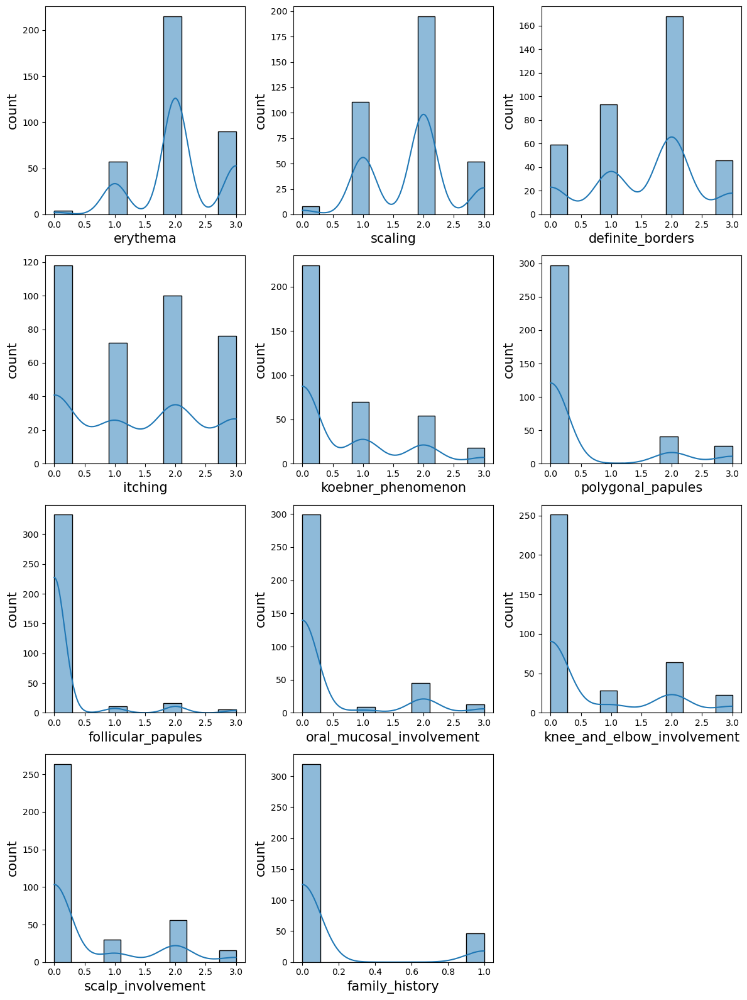

In [ ]:
# histplot
plt.figure(figsize=(12,16), facecolor='white')
plotnumber = 1

for clinical_features in Data:
    if plotnumber<=11 :
        ax = plt.subplot(4,3,plotnumber)
        sns.histplot(x=new_data[clinical_features],kde=True)
        plt.xlabel(clinical_features,fontsize=15)
        plt.ylabel('count',fontsize=15)
    plotnumber+=1
plt.tight_layout()

Insights:
The histogram allows us to visualize the distribution of a numerical variable, such as the 'age' column in your DataFrame. By plotting a histogram, we can understand the frequency and range of ages present in our dataset. This can help identify patterns or anomalies in the age distribution, such as whether it is skewed, normally distributed, or has any significant peaks or gaps.

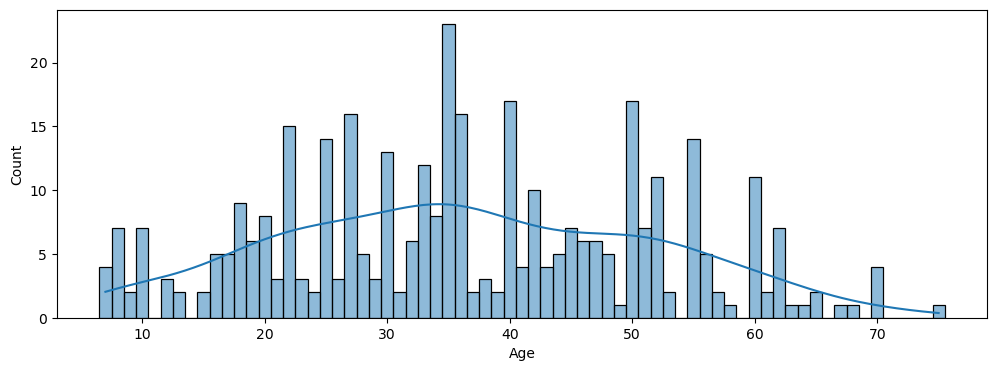

In [ ]:
plt.figure(figsize=(12,4))
sns.histplot(x=new_data['Age'],kde=True, discrete=True)
plt.show()

## Count and Distribution of Histopathological Features

In [ ]:
histopath_features = ['melanin_incontinence',
       'eosinophils_in_the_infiltrate', 'PNL_infiltrate',
       'fibrosis_of_the_papillary_dermis', 'exocytosis', 'acanthosis',
       'hyperkeratosis', 'parakeratosis', 'clubbing_of_the_rete_ridges',
       'elongation_of_the_rete_ridges',
       'thinning_of_the_suprapapillary_epidermis', 'spongiform_pustule',
       'munro_microabcess', 'focal_hypergranulosis',
       'disappearance_of_the_granular_layer',
       'vacuolisation_and_damage_of_basal_layer', 'spongiosis',
       'saw-tooth_appearance_of_retes', 'follicular_horn_plug',
       'perifollicular_parakeratosis', 'inflammatory_monoluclear_inflitrate',
       'band-like_infiltrate']

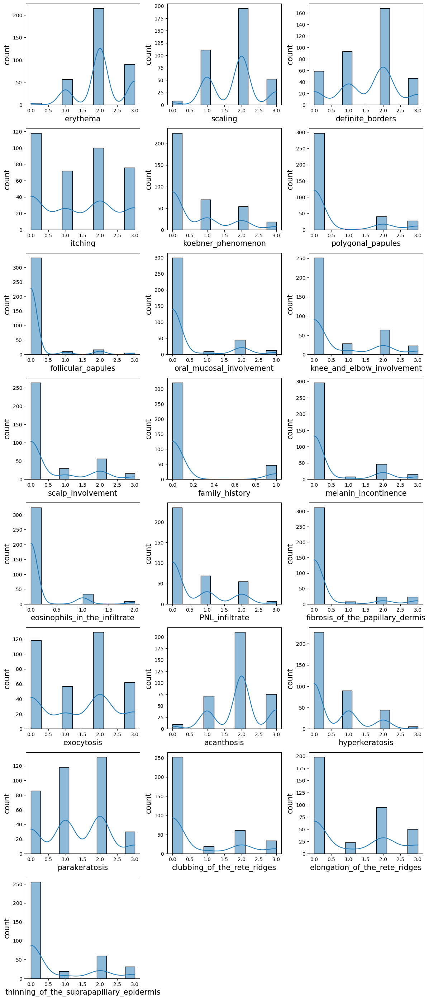

In [ ]:
# histplot
plt.figure(figsize=(12,28), facecolor='white')
plotnumber = 1

for histopath_features in Data:
    if plotnumber<=22 :
        ax = plt.subplot(8,3,plotnumber)
        sns.histplot(x=new_data[histopath_features],kde=True)
        plt.xlabel(histopath_features,fontsize=15)
        plt.ylabel('count',fontsize=15)
    plotnumber+=1
plt.tight_layout()
plt.show()

## Distribution and Count of Classes of Skin Disorders

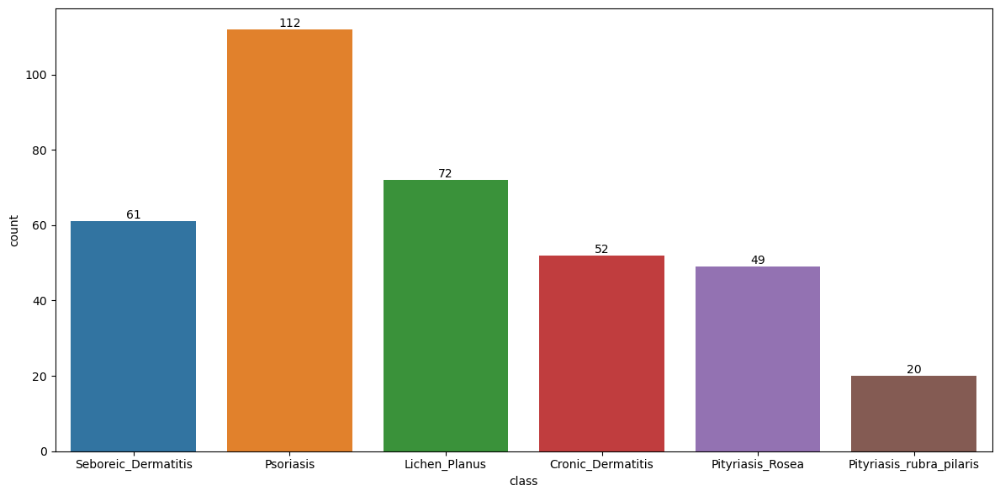

In [ ]:
plt.figure(figsize=(12,6))
ax=sns.countplot(x=Data['class'])
for label in ax.containers:
    ax.bar_label(label)
plt.tight_layout()

### Insights:
The bar plot is useful for visualizing the frequency or count of different categories in a categorical variable, such as the 'class' column in our DataFrame. By plotting a count plot, we can compare the number of instances for each class and gain insights into the class distribution. This visualization can reveal class imbalances, identify dominant or minority classes, or provide an overview of the distribution of the target variable.

<AxesSubplot:ylabel='class'>

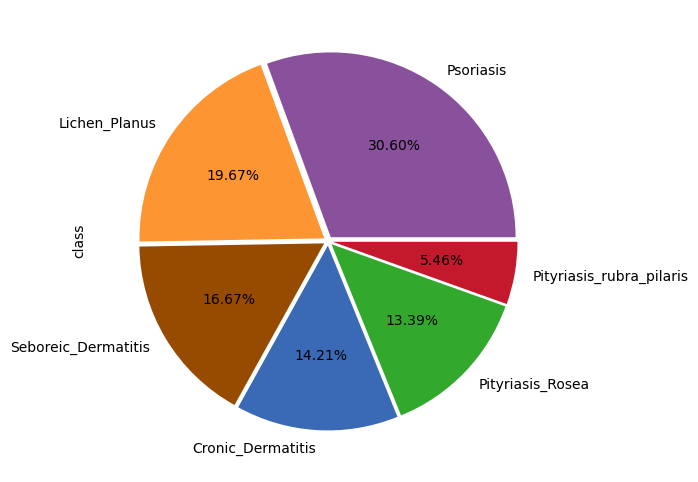

In [ ]:
plt.figure(figsize=(16,6))
new_data['class'].value_counts().plot(kind='pie', autopct='%0.02f%%', radius=1.0, pctdistance=0.6, colors= ['#89519c','#FC9532','#964B00','#3a69b5', '#32a82c','#c4182c'] ,explode = [0.025, 0.025, 0.025, 0.025, 0.025, 0.025])

## Age wise Distribution of classes of Skin diseases.

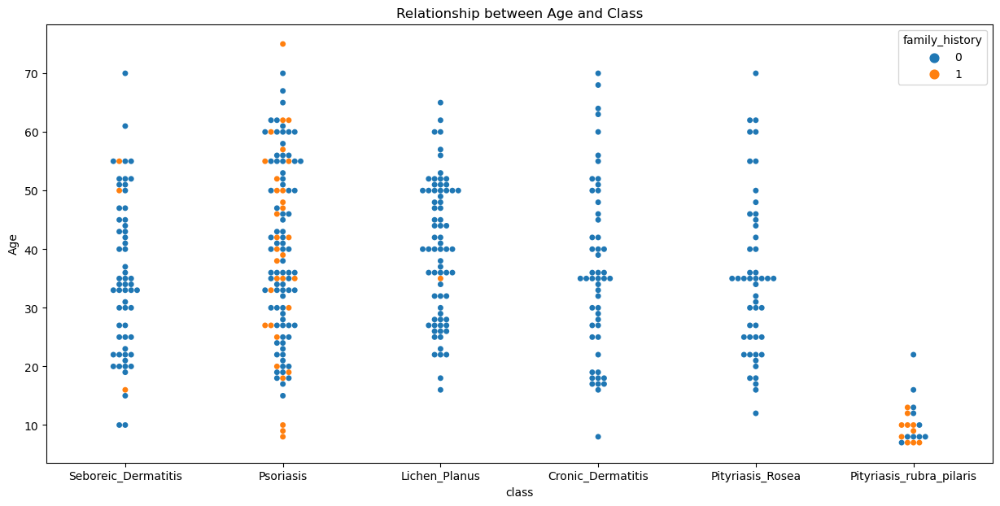

In [ ]:
plt.figure(figsize=(15,7))
sns.swarmplot(y="Age", x="class", data=new_data, hue='family_history')
plt.title('Relationship between Age and Class')
plt.show()

### OBSERVATIONS:
- Pityriasis_Rubra_Pilaris is only found ages below 20. This disease show high relation with family_history. It was observed in family_history of almost half of the patients.
- Except Pityriasis_Rubra_Pilaris, remaining class of diseases are found in almost all the ages.
- Psoriasis is also significantly related to the family history.

Note: you may need to restart the kernel to use updated packages.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
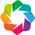

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (366, 35)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
  Printing upto 30 columns max in each category:
    Numeric Columns : []
    Integer-Categorical Columns: ['erythema', 'scaling', 'definite_borders', 'itching', 'koebner_phenomenon', 'polygonal_papules', 'follicular_papules', 'oral_mucosal_involvement', 'knee_and_elbow_involvement', 'scalp_involvement', 'melanin_incontinence', 'eosi

In [ ]:
%pip install autoviz
from autoviz.AutoViz_Class import AutoViz_Class
AV=AutoViz_Class()

df=AV.AutoViz(filename='skin disorder.csv',verbose=2,chart_format='html')

In [ ]:
## Univariate Analysis
!pip install sweetviz

In [ ]:
import sweetviz as sv#importing sweetviz library
my_report = sv.analyze(Data)#syntax to use sweetviz
my_report.show_html()#Default arguments will generate to "SWEETVIZ_REPORT.html"

                                             |                                             | [  0%]   00:00 ->…

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


# Data Preprocessing

## Cheaking for Missing Values

In [ ]:
new_data.isnull().sum()

erythema                                    0
scaling                                     0
definite_borders                            0
itching                                     0
koebner_phenomenon                          0
polygonal_papules                           0
follicular_papules                          0
oral_mucosal_involvement                    0
knee_and_elbow_involvement                  0
scalp_involvement                           0
family_history                              0
melanin_incontinence                        0
eosinophils_in_the_infiltrate               0
PNL_infiltrate                              0
fibrosis_of_the_papillary_dermis            0
exocytosis                                  0
acanthosis                                  0
hyperkeratosis                              0
parakeratosis                               0
clubbing_of_the_rete_ridges                 0
elongation_of_the_rete_ridges               0
thinning_of_the_suprapapillary_epi

## Cheaking for duplicates

In [ ]:
new_data.duplicated().sum()

0

In [ ]:
new_data

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,family_history,melanin_incontinence,eosinophils_in_the_infiltrate,PNL_infiltrate,fibrosis_of_the_papillary_dermis,exocytosis,acanthosis,hyperkeratosis,parakeratosis,clubbing_of_the_rete_ridges,elongation_of_the_rete_ridges,thinning_of_the_suprapapillary_epidermis,spongiform_pustule,munro_microabcess,focal_hypergranulosis,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
0,2,2,0,3,0,0,0,0,1,0,0,0,0,0,0,3,2,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,55,Seboreic_Dermatitis
1,3,3,3,2,1,0,0,0,1,1,1,0,0,1,0,1,2,0,2,2,2,2,2,1,0,0,0,0,0,0,0,1,0,8,Psoriasis
2,2,1,2,3,1,3,0,3,0,0,0,1,0,0,0,1,2,0,2,0,0,0,0,0,2,0,2,3,2,0,0,2,3,26,Lichen_Planus
3,2,2,2,0,0,0,0,0,3,2,0,0,0,3,0,0,2,0,3,2,2,2,2,0,0,3,0,0,0,0,0,3,0,40,Psoriasis
4,2,3,2,2,2,2,0,2,0,0,0,1,0,0,0,1,2,0,0,0,0,0,0,0,2,2,3,2,3,0,0,2,3,45,Lichen_Planus
5,2,3,2,0,0,0,0,0,0,0,0,0,2,1,0,2,2,0,2,0,0,0,1,0,0,0,0,2,0,0,0,1,0,41,Seboreic_Dermatitis
6,2,1,0,2,0,0,0,0,0,0,0,0,0,0,3,1,3,0,0,0,2,0,0,0,0,0,0,0,0,0,0,2,0,18,Cronic_Dermatitis
7,2,2,3,3,3,3,0,2,0,0,0,2,0,0,0,2,3,0,0,0,0,0,0,0,0,2,2,3,2,0,0,3,3,57,Lichen_Planus
8,2,2,1,0,2,0,0,0,0,0,0,0,0,0,0,2,1,0,1,0,0,0,0,0,0,0,0,2,0,0,0,2,0,22,Pityriasis_Rosea
9,2,2,1,0,1,0,0,0,0,0,0,0,0,0,0,3,2,0,2,0,0,0,0,0,0,0,0,2,0,0,0,2,0,30,Pityriasis_Rosea


In [ ]:

new_data['class']=new_data['class'].map({'Psoriasis':0,'Seboreic_Dermatitis':1,'Lichen_Planus':2,'Pityriasis_Rosea':3,'Cronic_Dermatitis':4,'Pityriasis_rubra_pilaris':5})

In [ ]:
new_data

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,family_history,melanin_incontinence,eosinophils_in_the_infiltrate,PNL_infiltrate,fibrosis_of_the_papillary_dermis,exocytosis,acanthosis,hyperkeratosis,parakeratosis,clubbing_of_the_rete_ridges,elongation_of_the_rete_ridges,thinning_of_the_suprapapillary_epidermis,spongiform_pustule,munro_microabcess,focal_hypergranulosis,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
0,2,2,0,3,0,0,0,0,1,0,0,0,0,0,0,3,2,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,55,1
1,3,3,3,2,1,0,0,0,1,1,1,0,0,1,0,1,2,0,2,2,2,2,2,1,0,0,0,0,0,0,0,1,0,8,0
2,2,1,2,3,1,3,0,3,0,0,0,1,0,0,0,1,2,0,2,0,0,0,0,0,2,0,2,3,2,0,0,2,3,26,2
3,2,2,2,0,0,0,0,0,3,2,0,0,0,3,0,0,2,0,3,2,2,2,2,0,0,3,0,0,0,0,0,3,0,40,0
4,2,3,2,2,2,2,0,2,0,0,0,1,0,0,0,1,2,0,0,0,0,0,0,0,2,2,3,2,3,0,0,2,3,45,2
5,2,3,2,0,0,0,0,0,0,0,0,0,2,1,0,2,2,0,2,0,0,0,1,0,0,0,0,2,0,0,0,1,0,41,1
6,2,1,0,2,0,0,0,0,0,0,0,0,0,0,3,1,3,0,0,0,2,0,0,0,0,0,0,0,0,0,0,2,0,18,4
7,2,2,3,3,3,3,0,2,0,0,0,2,0,0,0,2,3,0,0,0,0,0,0,0,0,2,2,3,2,0,0,3,3,57,2
8,2,2,1,0,2,0,0,0,0,0,0,0,0,0,0,2,1,0,1,0,0,0,0,0,0,0,0,2,0,0,0,2,0,22,3
9,2,2,1,0,1,0,0,0,0,0,0,0,0,0,0,3,2,0,2,0,0,0,0,0,0,0,0,2,0,0,0,2,0,30,3


## Understanding Data using t-SNE

**t-SNE (t-Distributed Stochastic Neighbor Embedding) is a dimensionality reduction technique used to visualize high-dimensional data in a lower-dimensional space. In this section, we apply t-SNE to gain a better understanding of the data's structure and identify potential clusters or patterns that may exist in the dataset.**

In [ ]:
x = new_data.iloc[:, :-1].values
y = new_data.iloc[:, -1].values

In [ ]:
Data['class'].value_counts()

Psoriasis                   112
Lichen_Planus                72
Seboreic_Dermatitis          61
Cronic_Dermatitis            52
Pityriasis_Rosea             49
Pityriasis_rubra_pilaris     20
Name: class, dtype: int64

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 366 samples in 0.000s...
[t-SNE] Computed neighbors for 366 samples in 0.010s...
[t-SNE] Computed conditional probabilities for sample 366 / 366
[t-SNE] Mean sigma: 3.524986
[t-SNE] Computed conditional probabilities in 0.012s
[t-SNE] Iteration 50: error = 57.1255455, gradient norm = 0.5336117 (50 iterations in 0.088s)
[t-SNE] Iteration 100: error = 57.6475143, gradient norm = 0.5088434 (50 iterations in 0.095s)
[t-SNE] Iteration 150: error = 57.7040215, gradient norm = 0.4848466 (50 iterations in 0.083s)
[t-SNE] Iteration 200: error = 57.5671120, gradient norm = 0.5165014 (50 iterations in 0.079s)
[t-SNE] Iteration 250: error = 57.8297844, gradient norm = 0.5014625 (50 iterations in 0.086s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.829784
[t-SNE] Iteration 300: error = 0.3586234, gradient norm = 0.0020080 (50 iterations in 0.076s)
[t-SNE] Iteration 350: error = 0.3312033, gradient norm = 0.0003459 (

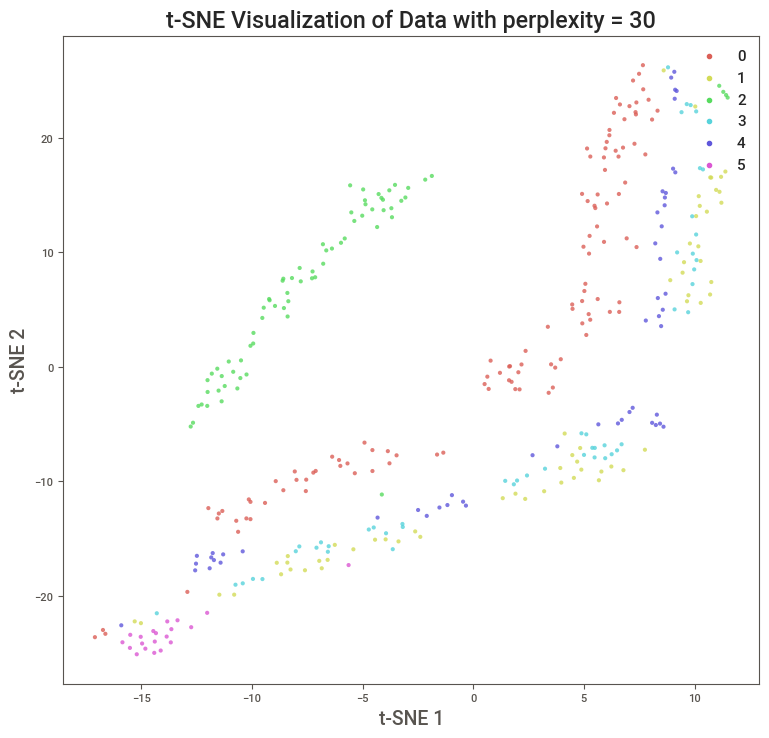

In [ ]:
from sklearn.manifold import TSNE

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=110, verbose=2)
x_tsne = tsne.fit_transform(x)


# Create a scatterplot of the t-SNE graph
plt.figure(figsize=(8, 8))
sns.scatterplot(
    x=x_tsne[:,0], y=x_tsne[:,1],
    hue=y, palette=sns.color_palette("hls", len(np.unique(y))),
    alpha=0.8, edgecolor='none'
)


plt.title('t-SNE Plot for Dermatology Dataset')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.title('t-SNE Visualization of Data with perplexity = 30')
plt.legend(loc='upper right')
plt.show()

[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 366 samples in 0.000s...
[t-SNE] Computed neighbors for 366 samples in 0.011s...
[t-SNE] Computed conditional probabilities for sample 366 / 366
[t-SNE] Mean sigma: 6.280893
[t-SNE] Computed conditional probabilities in 0.036s
[t-SNE] Iteration 50: error = 49.3784943, gradient norm = 0.5172608 (50 iterations in 0.115s)
[t-SNE] Iteration 100: error = 49.4577103, gradient norm = 0.5292695 (50 iterations in 0.109s)
[t-SNE] Iteration 150: error = 48.7634850, gradient norm = 0.5429070 (50 iterations in 0.112s)
[t-SNE] Iteration 200: error = 50.3769875, gradient norm = 0.5037864 (50 iterations in 0.114s)
[t-SNE] Iteration 250: error = 50.7982559, gradient norm = 0.5071046 (50 iterations in 0.112s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.798256
[t-SNE] Iteration 300: error = 0.1411521, gradient norm = 0.0018546 (50 iterations in 0.102s)
[t-SNE] Iteration 350: error = 0.1293141, gradient norm = 0.0001147 

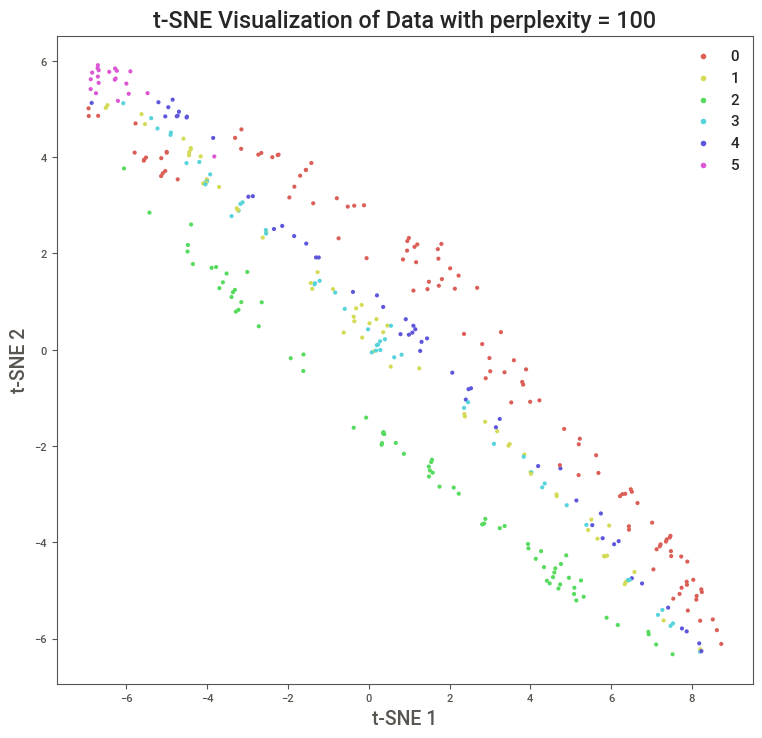

In [ ]:
# Apply t-SNE with higher perplexity
tsne = TSNE(n_components=2, random_state=110, verbose=2, perplexity = 100)
x_tsne = tsne.fit_transform(x)


# Create a scatterplot of the t-SNE graph
plt.figure(figsize=(8, 8))
sns.scatterplot(
    x=x_tsne[:,0], y=x_tsne[:,1],
    hue=y, palette=sns.color_palette("hls", len(np.unique(y))),
    alpha=1, edgecolor='none'
)


plt.title('t-SNE Plot for Dermatology Dataset')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.title('t-SNE Visualization of Data with perplexity = 100')
plt.legend(loc='upper right')
plt.show()

[t-SNE] Computing 365 nearest neighbors...
[t-SNE] Indexed 366 samples in 0.000s...
[t-SNE] Computed neighbors for 366 samples in 0.014s...
[t-SNE] Computed conditional probabilities for sample 366 / 366
[t-SNE] Mean sigma: 11.282985
[t-SNE] Computed conditional probabilities in 0.059s
[t-SNE] Iteration 50: error = 44.1165619, gradient norm = 0.5170186 (50 iterations in 0.134s)
[t-SNE] Iteration 100: error = 47.9103394, gradient norm = 0.4812503 (50 iterations in 0.140s)
[t-SNE] Iteration 150: error = 45.3209267, gradient norm = 0.5217642 (50 iterations in 0.125s)
[t-SNE] Iteration 200: error = 44.2054596, gradient norm = 0.5129660 (50 iterations in 0.131s)
[t-SNE] Iteration 250: error = 45.7303619, gradient norm = 0.5127408 (50 iterations in 0.137s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 45.730362
[t-SNE] Iteration 300: error = 0.0371398, gradient norm = 0.0025124 (50 iterations in 0.115s)
[t-SNE] Iteration 350: error = 0.0319825, gradient norm = 0.0001162

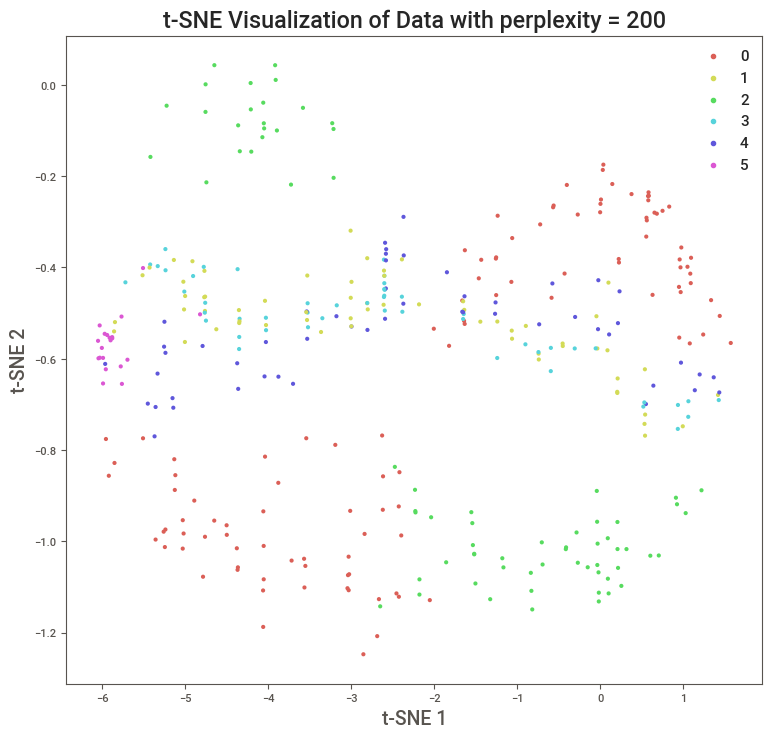

In [ ]:
# Apply t-SNE with more high perplexity
tsne = TSNE(n_components=2, random_state=110, verbose=2, perplexity = 200)
x_tsne = tsne.fit_transform(x)


# Create a scatterplot of the t-SNE graph
plt.figure(figsize=(8, 8))
sns.scatterplot(
    x=x_tsne[:,0], y=x_tsne[:,1],
    hue=y, palette=sns.color_palette("hls", len(np.unique(y))),
    alpha=1, edgecolor='none'
)


# plt.title('t-SNE Plot for Dermatology Dataset')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.title('t-SNE Visualization of Data with perplexity = 200')
plt.legend(loc='upper right')
plt.show()

* Upon analyzing the dataset, we can observe that the class features **'0', '2', and '5'** appear to be well separated and distinguishable. However, the class features **'1', '3', and '4'** exhibit overlapping patterns, making it challenging to separate them effectively. This overlapping nature may pose difficulties for our model, as it may struggle to accurately classify instances belonging to these classes. We can further examine this observation by reviewing the confusion matrix and classification report during the model evaluation process.

In [ ]:
# Calculate the correlation matrix
corr_matrix = new_data.corr()

corr_matrix

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,family_history,melanin_incontinence,eosinophils_in_the_infiltrate,PNL_infiltrate,fibrosis_of_the_papillary_dermis,exocytosis,acanthosis,hyperkeratosis,parakeratosis,clubbing_of_the_rete_ridges,elongation_of_the_rete_ridges,thinning_of_the_suprapapillary_epidermis,spongiform_pustule,munro_microabcess,focal_hypergranulosis,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
erythema,1.000000,0.435467,0.260087,-0.047623,0.000694,0.033571,-0.109550,-0.026810,0.141008,0.186684,0.172059,0.042126,0.075228,0.224095,-0.354595,0.021565,0.064165,-0.055432,0.210030,0.157558,0.007819,0.167868,0.169773,0.113464,-0.013761,0.159100,0.002559,0.022468,-0.005779,-0.005450,0.009539,0.075758,-0.006955,-0.014001,-0.335537
scaling,0.435467,1.000000,0.357987,-0.084197,-0.010576,-0.075035,-0.092400,-0.082969,0.298398,0.301577,0.181491,-0.074856,0.042211,0.282486,-0.383585,-0.110809,0.108095,0.013149,0.296752,0.320740,0.139073,0.330343,0.297783,0.186366,-0.085021,0.211484,-0.109523,0.012151,-0.114467,-0.010518,-0.011135,-0.010977,-0.132079,0.010195,-0.468688
definite_borders,0.260087,0.357987,1.000000,-0.062564,0.241342,0.327754,-0.166662,0.286684,0.302309,0.268862,0.115844,0.311398,-0.132021,0.041330,-0.274414,-0.205391,0.189761,0.043894,0.361213,0.387205,0.201702,0.369266,0.246204,0.242232,0.291147,0.354768,0.298095,-0.255536,0.274576,-0.086250,-0.123947,0.111882,0.282578,0.135103,-0.391974
itching,-0.047623,-0.084197,-0.062564,1.000000,0.267878,0.409696,-0.144825,0.359163,-0.299645,-0.155639,-0.136615,0.359207,0.095434,-0.145288,0.203032,0.214822,0.067080,-0.008460,-0.075568,-0.232224,-0.124058,-0.244052,-0.152689,-0.056056,0.363488,-0.192684,0.367650,0.017514,0.376186,-0.175866,-0.184074,0.062781,0.386691,0.044865,0.054772
koebner_phenomenon,0.000694,-0.010576,0.241342,0.267878,1.000000,0.394108,-0.172741,0.392554,-0.066372,0.015202,-0.083247,0.385687,-0.046366,-0.169377,-0.247451,0.145960,-0.054449,0.002635,-0.036801,0.008471,-0.163819,0.026064,-0.002065,0.157646,0.400409,0.004327,0.376473,-0.005938,0.381687,-0.147955,-0.164364,0.083358,0.382844,0.083811,-0.091323
polygonal_papules,0.033571,-0.075035,0.327754,0.409696,0.394108,1.000000,-0.137093,0.865142,-0.276058,-0.253234,-0.151841,0.907044,0.028824,-0.314515,-0.158046,0.379643,0.129210,-0.164355,-0.042098,-0.294857,-0.400544,-0.287468,-0.206530,-0.201893,0.880972,-0.119698,0.911626,0.080063,0.895107,-0.095477,-0.110204,0.228426,0.905822,0.093712,0.057785
follicular_papules,-0.109550,-0.092400,-0.166662,-0.144825,-0.172741,-0.137093,1.000000,-0.132394,0.222255,-0.003535,0.192866,-0.136165,-0.087452,-0.119728,0.019698,-0.010869,-0.096592,0.189201,-0.029654,-0.115856,-0.105356,-0.128361,-0.057283,-0.095856,-0.118710,-0.157296,-0.139960,-0.013454,-0.139141,0.785282,0.844929,-0.084864,-0.133871,-0.375243,0.477813
oral_mucosal_involvement,-0.026810,-0.082969,0.286684,0.359163,0.392554,0.865142,-0.132394,1.000000,-0.283466,-0.259813,-0.151825,0.869231,0.014122,-0.303735,-0.140047,0.360138,0.101565,-0.155177,-0.039258,-0.284750,-0.386815,-0.277615,-0.199452,-0.190861,0.884351,-0.106704,0.887552,0.120344,0.875209,-0.082601,-0.106426,0.250937,0.892341,0.108523,0.055805
knee_and_elbow_involvement,0.141008,0.298398,0.302309,-0.299645,-0.066372,-0.276058,0.222255,-0.283466,1.000000,0.659206,0.341915,-0.272314,-0.198670,0.331709,-0.227428,-0.529946,0.116711,0.229538,0.439951,0.721602,0.496067,0.644669,0.447252,0.518155,-0.267508,0.481743,-0.282151,-0.413200,-0.280395,0.232903,0.257661,-0.068621,-0.276711,-0.068906,-0.383305
scalp_involvement,0.186684,0.301577,0.268862,-0.155639,0.015202,-0.253234,-0.003535,-0.259813,0.659206,1.000000,0.292728,-0.256779,-0.076957,0

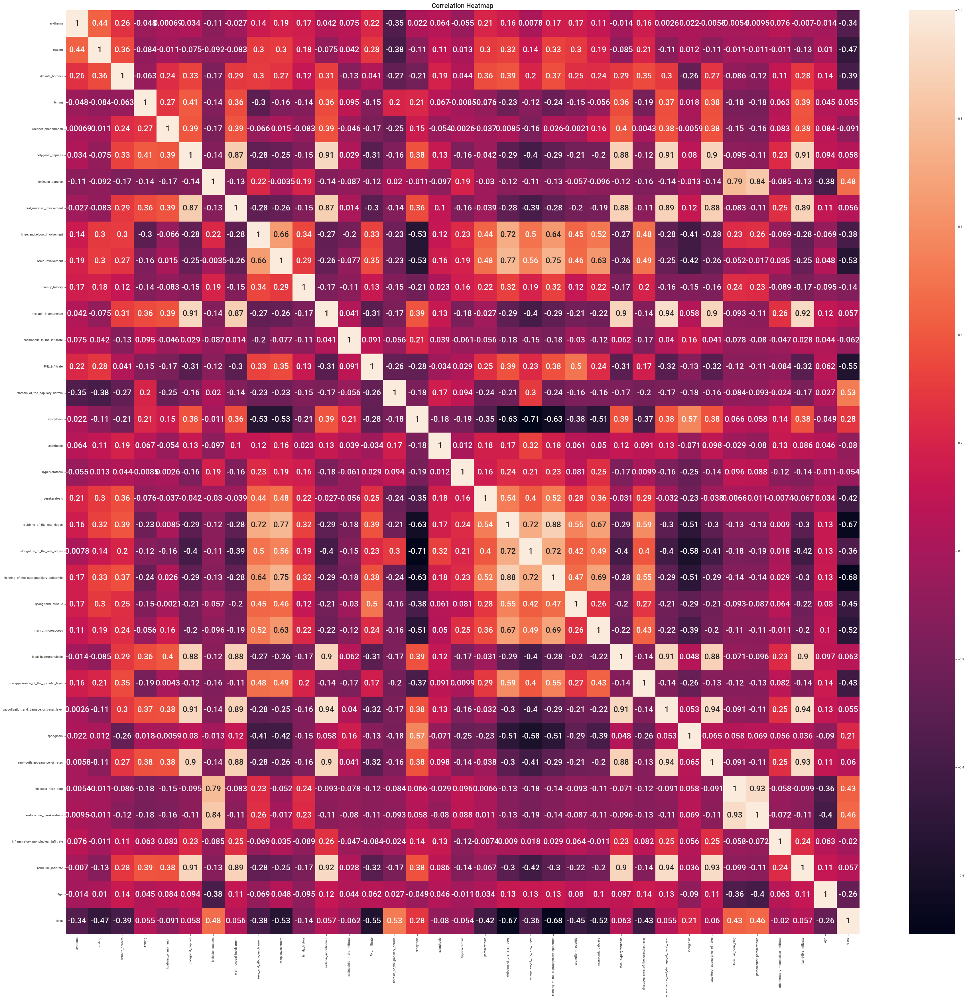

In [ ]:
# Plot the correlation heatmap
plt.figure(figsize=(40, 40))
sns.heatmap(corr_matrix, annot=True,annot_kws={"size":20})
plt.title('Correlation Heatmap')
plt.show()

## split data into x and y

In [ ]:
x=new_data.drop(columns=["class"])
y=new_data['class']

In [ ]:
new_data

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,family_history,melanin_incontinence,eosinophils_in_the_infiltrate,PNL_infiltrate,fibrosis_of_the_papillary_dermis,exocytosis,acanthosis,hyperkeratosis,parakeratosis,clubbing_of_the_rete_ridges,elongation_of_the_rete_ridges,thinning_of_the_suprapapillary_epidermis,spongiform_pustule,munro_microabcess,focal_hypergranulosis,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
0,2,2,0,3,0,0,0,0,1,0,0,0,0,0,0,3,2,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,55,1
1,3,3,3,2,1,0,0,0,1,1,1,0,0,1,0,1,2,0,2,2,2,2,2,1,0,0,0,0,0,0,0,1,0,8,0
2,2,1,2,3,1,3,0,3,0,0,0,1,0,0,0,1,2,0,2,0,0,0,0,0,2,0,2,3,2,0,0,2,3,26,2
3,2,2,2,0,0,0,0,0,3,2,0,0,0,3,0,0,2,0,3,2,2,2,2,0,0,3,0,0,0,0,0,3,0,40,0
4,2,3,2,2,2,2,0,2,0,0,0,1,0,0,0,1,2,0,0,0,0,0,0,0,2,2,3,2,3,0,0,2,3,45,2
5,2,3,2,0,0,0,0,0,0,0,0,0,2,1,0,2,2,0,2,0,0,0,1,0,0,0,0,2,0,0,0,1,0,41,1
6,2,1,0,2,0,0,0,0,0,0,0,0,0,0,3,1,3,0,0,0,2,0,0,0,0,0,0,0,0,0,0,2,0,18,4
7,2,2,3,3,3,3,0,2,0,0,0,2,0,0,0,2,3,0,0,0,0,0,0,0,0,2,2,3,2,0,0,3,3,57,2
8,2,2,1,0,2,0,0,0,0,0,0,0,0,0,0,2,1,0,1,0,0,0,0,0,0,0,0,2,0,0,0,2,0,22,3
9,2,2,1,0,1,0,0,0,0,0,0,0,0,0,0,3,2,0,2,0,0,0,0,0,0,0,0,2,0,0,0,2,0,30,3


## split data for training and testing

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test =train_test_split(x,y, test_size=0.3, random_state=42)

In [ ]:
y_train.value_counts()

0    72
2    53
1    45
4    36
3    34
5    16
Name: class, dtype: int64

In [ ]:
x.shape, y.shape

((366, 34), (366,))

In [ ]:
print("The shape of x_train is:", x_train.shape)
print("The shape of x_test is:", x_test.shape)
print("The shape of Y_train is:", y_train.shape)
print("The shape of Y_test is:", y_test.shape)

The shape of x_train is: (256, 34)
The shape of x_test is: (110, 34)
The shape of Y_train is: (256,)
The shape of Y_test is: (110,)


# Model Building

In [ ]:
# MODELS
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier

## 1. Logistic Regression

In [ ]:
Log_Reg = LogisticRegression()
Log_Reg.fit(x_train, y_train)

LogisticRegression()

In [ ]:
# MODEL EVALUATION
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score
y_train_pred_Log_Reg = Log_Reg.predict(x_train) # training model
y_test_pred_Log_Reg = Log_Reg.predict(x_test) # testing model

In [ ]:
#Evaluate Logistic Regression model:
print("Logistic Regression training set score:" , accuracy_score(y_train, y_train_pred_Log_Reg))
print("Logistic Regression test set score:" , accuracy_score(y_test, y_test_pred_Log_Reg))

Logistic Regression training set score: 1.0
Logistic Regression test set score: 0.9727272727272728


In [ ]:
# Classification Report of Tuned Logistic Regression Model
print(classification_report(y_test, y_test_pred_Log_Reg, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      1.00      1.00        40
     seboreic_dermatitis       0.88      0.94      0.91        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.93      0.87      0.90        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      1.00      1.00         4

                accuracy                           0.97       110
               macro avg       0.97      0.97      0.97       110
            weighted avg       0.97      0.97      0.97       110



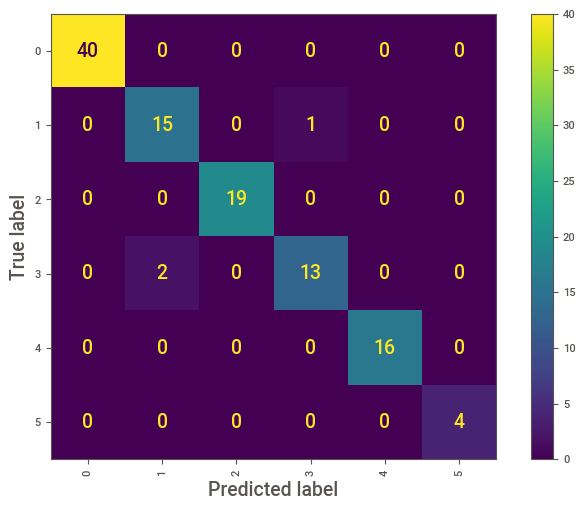

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_Log_Reg, xticks_rotation='vertical')

## 2. K- Nearest Neighbors Classifier

In [ ]:
KNN_CLF = KNeighborsClassifier()
KNN_CLF.fit(x_train,y_train)

KNeighborsClassifier()

In [ ]:
y_train_pred_KNN_CLF = KNN_CLF.predict(x_train)
y_test_pred_KNN_CLF = KNN_CLF.predict(x_test)

In [ ]:
#Evaluate KNN model:
print("KNN training set score:",  accuracy_score(y_train, y_train_pred_KNN_CLF))
print("KNN test set score:", accuracy_score(y_test, y_test_pred_KNN_CLF))

KNN training set score: 0.92578125
KNN test set score: 0.8090909090909091


In [ ]:
# Classification Report of KNN Classifier Model
print(classification_report(y_test, y_test_pred_KNN_CLF, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      0.93      0.96        40
     seboreic_dermatitis       0.59      0.62      0.61        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.48      0.67      0.56        15
       cronic_dermatitis       0.83      0.62      0.71        16
pityriasis_rubra_pilaris       0.75      0.75      0.75         4

                accuracy                           0.81       110
               macro avg       0.77      0.77      0.76       110
            weighted avg       0.84      0.81      0.82       110



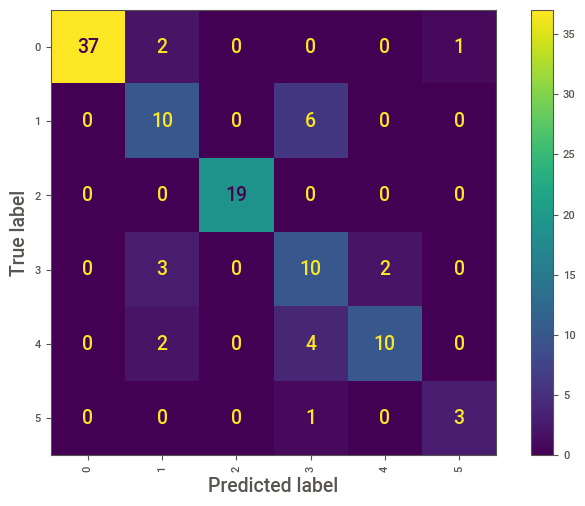

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_KNN_CLF, xticks_rotation='vertical')

In [ ]:
KNN_CLF.get_params()

{'algorithm': 'auto',
 'leaf_size': 30,
 'metric': 'minkowski',
 'metric_params': None,
 'n_jobs': None,
 'n_neighbors': 5,
 'p': 2,
 'weights': 'uniform'}

In [ ]:
# Defining Parameters' ranges for Tuning
params_KNN_CLF= {'n_neighbors':[2,3,4,5,6,7,8,9,10],
         'weights':["uniform", "distance"],
         'metric':['minkowski', 'chebyshev','euclidean','manhattan'],
         'algorithm':['auto', 'ball_tree', 'kd_tree', 'brute'],
         'leaf_size': [20,30,40,50,60,70,80,90,100],
         'p': [1,2,3,4]}

In [ ]:
# %%time
from sklearn.model_selection import  GridSearchCV
grid_search_KNN_CLF= KNeighborsClassifier()
grid_search_KNN_CLF = GridSearchCV(grid_search_KNN_CLF, params_KNN_CLF,cv=5,scoring='accuracy',n_jobs=-1)

grid_result_KNN_CLF= grid_search_KNN_CLF.fit(x_train, y_train)
print('Best Params: ', grid_result_KNN_CLF.best_params_)

Best Params:  {'algorithm': 'ball_tree', 'leaf_size': 60, 'metric': 'minkowski', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}


In [ ]:
KNN_CLF_Tuned = KNeighborsClassifier(algorithm='ball_tree', leaf_size= 20, metric= 'minkowski', n_neighbors= 10, p=1, weights= 'distance')
KNN_CLF_Tuned.fit(x_train, y_train)

KNeighborsClassifier(algorithm='ball_tree', leaf_size=20, n_neighbors=10, p=1,
                     weights='distance')

In [ ]:
y_train_pred_KNN_CLF_Tuned= KNN_CLF_Tuned.predict(x_train) # training model
y_test_pred_KNN_CLF_Tuned = KNN_CLF_Tuned.predict(x_test) # testing model

In [ ]:
#Evaluate Tuned KNN Classifier model:
print("KNN Tuned training set score:", accuracy_score(y_train, y_train_pred_KNN_CLF_Tuned))
print("KNN Tuned test set score:", accuracy_score(y_test, y_test_pred_KNN_CLF_Tuned))

KNN Tuned training set score: 1.0
KNN Tuned test set score: 0.9363636363636364


In [ ]:
# Classification Report of Tuned KNN Classifier Model
print(classification_report(y_test, y_test_pred_KNN_CLF_Tuned, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      0.97      0.99        40
     seboreic_dermatitis       0.81      0.81      0.81        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.76      0.87      0.81        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      0.75      0.86         4

                accuracy                           0.94       110
               macro avg       0.93      0.90      0.91       110
            weighted avg       0.94      0.94      0.94       110



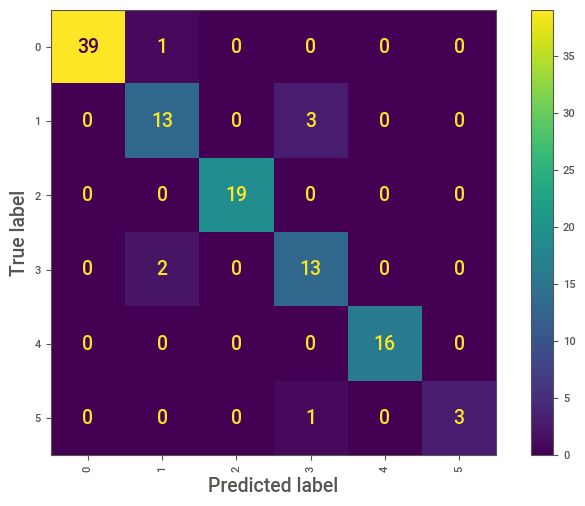

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_KNN_CLF_Tuned, xticks_rotation='vertical')


## 3. Support Vector Classifier

In [ ]:
SVC = SVC(class_weight='balanced')
SVC.fit(x_train, y_train)

SVC(class_weight='balanced')

In [ ]:
y_train_pred_SVC=SVC.predict(x_train)
y_test_pred_SVC=SVC.predict(x_test)

In [ ]:
#Evaluate SVC model:
print("SVC training set score:", accuracy_score(y_train, y_train_pred_SVC))
print("SVC test set score:", accuracy_score(y_test, y_test_pred_SVC))

SVC training set score: 0.796875
SVC test set score: 0.7363636363636363


In [ ]:
# Classification Report of Support Vector Classifier Model
print(classification_report(y_test, y_test_pred_SVC, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       0.92      0.88      0.90        40
     seboreic_dermatitis       0.41      0.56      0.47        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.70      0.47      0.56        15
       cronic_dermatitis       0.47      0.50      0.48        16
pityriasis_rubra_pilaris       0.75      0.75      0.75         4

                accuracy                           0.74       110
               macro avg       0.71      0.69      0.69       110
            weighted avg       0.76      0.74      0.74       110



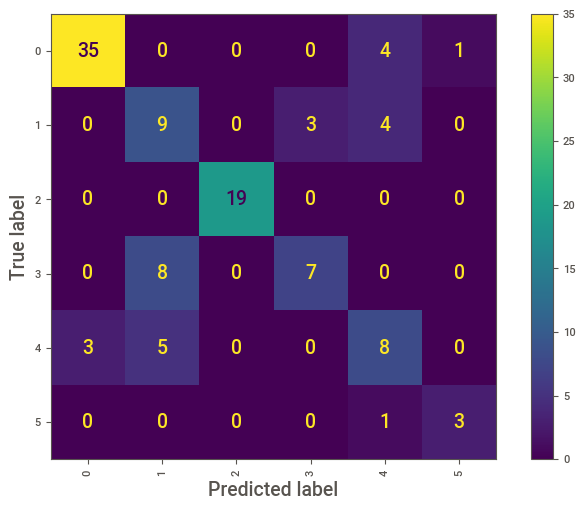

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_SVC, xticks_rotation='vertical')

In [ ]:
SVC.get_params()

{'C': 1.0,
 'break_ties': False,
 'cache_size': 200,
 'class_weight': 'balanced',
 'coef0': 0.0,
 'decision_function_shape': 'ovr',
 'degree': 3,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'probability': False,
 'random_state': None,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [ ]:
# Defining Parameters' ranges for Tuning
params_SVM_CLF= {'C':[0.1,5,10,50,60,70],'gamma':[1,0.1,0.01,0.001,0.001],
            'random_state':list(range(1,20)),'kernel':['rbf','poly','sigmoid','linear']}

In [ ]:
# %%time
from sklearn.model_selection import  GridSearchCV
grid_search_SVM_CLF= SVC()
grid_search_SVM_CLF = GridSearchCV(grid_search_SVM_CLF, params_SVM_CLF,cv=5,scoring='accuracy',n_jobs=-1)

grid_result_SVM_CLF= grid_search_SVM_CLF.fit(x_train, y_train)
print('Best Params: ', grid_result_SVM_CLF.best_params_)

Best Params:  {'C': 5, 'gamma': 1, 'kernel': 'linear', 'random_state': 1}


In [ ]:
SVM_CLF_Tuned = SVC(C=5, gamma=1, kernel= 'linear', random_state=1)
SVM_CLF_Tuned.fit(x_train, y_train)

SVC(C=5, gamma=1, kernel='linear', random_state=1)

In [ ]:
y_train_pred_SVM_CLF_Tuned= SVM_CLF_Tuned.predict(x_train) # training model
y_test_pred_SVM_CLF_Tuned = SVM_CLF_Tuned.predict(x_test) # testing model

In [ ]:
#Evaluate Tuned KNN Classifier model:
print("SVC Tuned training set score:", accuracy_score(y_train, y_train_pred_SVM_CLF_Tuned))
print("SVC Tuned test set score:", accuracy_score(y_test, y_test_pred_SVM_CLF_Tuned))

SVC Tuned training set score: 1.0
SVC Tuned test set score: 0.9636363636363636


In [ ]:
# Classification Report of Tuned KNN Classifier Model
print(classification_report(y_test, y_test_pred_SVM_CLF_Tuned, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      1.00      1.00        40
     seboreic_dermatitis       0.83      0.94      0.88        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.93      0.87      0.90        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      0.75      0.86         4

                accuracy                           0.96       110
               macro avg       0.96      0.93      0.94       110
            weighted avg       0.97      0.96      0.96       110



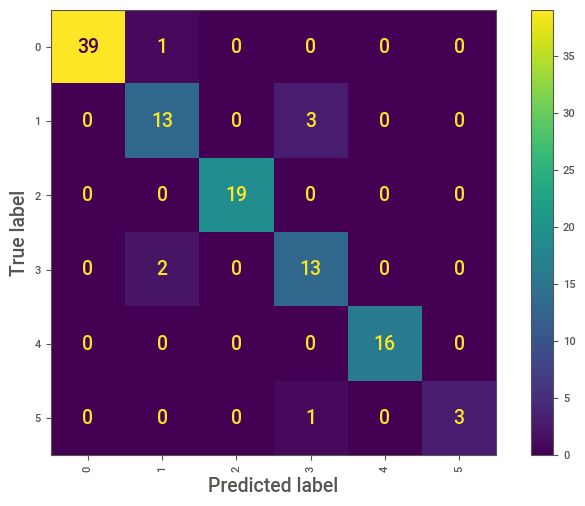

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_KNN_CLF_Tuned, xticks_rotation='vertical')

## 4. Decision Tree Classifier

In [ ]:
DTC = DecisionTreeClassifier()
DTC.fit(x_train, y_train)

DecisionTreeClassifier()

In [ ]:
y_train_pred_DTC = DTC.predict(x_train)
y_test_pred_DTC = DTC.predict(x_test)

In [ ]:
#Evaluate DTC model:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score
print("DTC training set score:", accuracy_score(y_train, y_train_pred_DTC))
print("DTC test set score:",  accuracy_score(y_test, y_test_pred_DTC))

DTC training set score: 1.0
DTC test set score: 0.9727272727272728


In [ ]:
# Classification Report of DTC Classfier Model
print(classification_report(y_test, y_test_pred_DTC, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       0.98      1.00      0.99        40
     seboreic_dermatitis       0.94      0.94      0.94        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.93      0.93      0.93        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      0.75      0.86         4

                accuracy                           0.97       110
               macro avg       0.97      0.94      0.95       110
            weighted avg       0.97      0.97      0.97       110



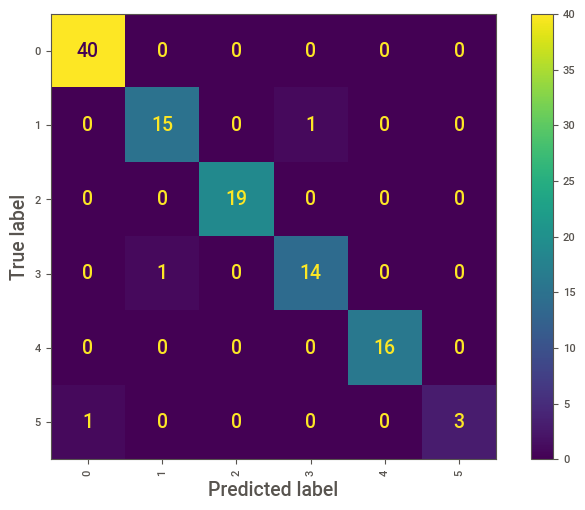

In [ ]:

from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_DTC, xticks_rotation='vertical')

## 5. Random Forest Classifier

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score
RFC = RandomForestClassifier(random_state=42)
RFC.fit(x_train, y_train)

RandomForestClassifier(random_state=42)

In [ ]:
y_train_pred_RFC=RFC.predict(x_train)
y_test_pred_RFC=RFC.predict(x_test)

In [ ]:
#Evaluate RF Classifier model:

print("RFC Classifier training set score:", accuracy_score(y_train,y_train_pred_RFC))
print("RFC Classifier test set score:", accuracy_score(y_test, y_test_pred_RFC))

RFC Classifier training set score: 1.0
RFC Classifier test set score: 0.9636363636363636


In [ ]:
# Classification Report of RF Classifier Model
print(classification_report(y_test, y_test_pred_RFC, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      1.00      1.00        40
     seboreic_dermatitis       0.83      0.94      0.88        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.92      0.80      0.86        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      1.00      1.00         4

                accuracy                           0.96       110
               macro avg       0.96      0.96      0.96       110
            weighted avg       0.97      0.96      0.96       110



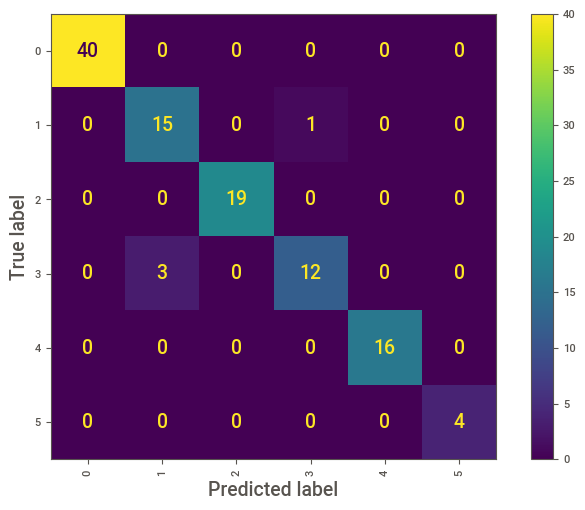

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_RFC, xticks_rotation='vertical')

## 6. Multinomial Naive Bayes Classifier

In [ ]:
MNBC = MultinomialNB()
MNBC.fit(x_train, y_train)

MultinomialNB()

In [ ]:
y_train_pred_MNBC = MNBC.predict(x_train) # training model
y_test_pred_MNBC = MNBC.predict(x_test)

In [ ]:
#Evaluate Multinomial Naive Bayes model:
print("Multinomial Naive Bayes training set score:", accuracy_score(y_train, y_train_pred_MNBC))
print("Multinomial Naive Bayes test set score:", accuracy_score(y_test, y_test_pred_MNBC))

Multinomial Naive Bayes training set score: 0.984375
Multinomial Naive Bayes test set score: 0.9818181818181818


In [ ]:
# Classification Report of Multinomial Naive Bayes Model
print(classification_report(y_test, y_test_pred_MNBC, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      1.00      1.00        40
     seboreic_dermatitis       0.94      0.94      0.94        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.93      0.93      0.93        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      1.00      1.00         4

                accuracy                           0.98       110
               macro avg       0.98      0.98      0.98       110
            weighted avg       0.98      0.98      0.98       110



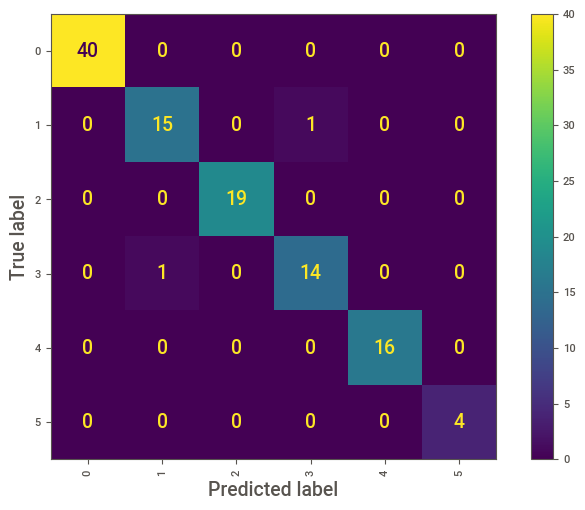

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_MNBC, xticks_rotation='vertical')

## 7. Gradient Boosting Classifier

In [ ]:
GBC = GradientBoostingClassifier(random_state=42)
GBC.fit(x_train, y_train)

GradientBoostingClassifier(random_state=42)

In [ ]:

y_train_pred_GBC = GBC.predict(x_train)
y_test_pred_GBC= GBC.predict(x_test)

In [ ]:
#Evaluate GBC model:
print("GBC training set score:", accuracy_score(y_train,y_train_pred_GBC))
print("GBC test set score:", accuracy_score(y_test, y_test_pred_GBC))

GBC training set score: 1.0
GBC test set score: 0.9636363636363636


In [ ]:
# Classification Report of GBC Model
print(classification_report(y_test, y_test_pred_GBC, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      1.00      1.00        40
     seboreic_dermatitis       0.83      0.94      0.88        16
           lichen_planus       1.00      0.95      0.97        19
        pityriasis_rosea       0.93      0.87      0.90        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      1.00      1.00         4

                accuracy                           0.96       110
               macro avg       0.96      0.96      0.96       110
            weighted avg       0.97      0.96      0.96       110



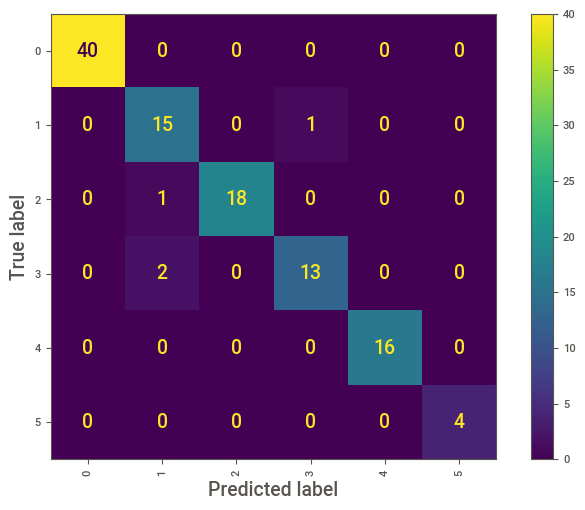

In [ ]:
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_GBC, xticks_rotation='vertical')

## 8. XG Boost Classifier

In [ ]:
XGB_CLF = XGBClassifier()
XGB_CLF.fit(x_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [ ]:
y_train_pred_XGB_CLF =XGB_CLF.predict(x_train)
y_test_pred_XGB_CLF=XGB_CLF.predict(x_test)

In [ ]:
#Evaluate XGB Classifier model:
print("XGB_CLF training set score:", accuracy_score(y_train,y_train_pred_XGB_CLF))
print("XGB_CLF test set score:", accuracy_score(y_test, y_test_pred_XGB_CLF))

XGB_CLF training set score: 1.0
XGB_CLF test set score: 0.9636363636363636


In [ ]:
# Classification Report of XGB Classifier Model
print(classification_report(y_test, y_test_pred_XGB_CLF, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      1.00      1.00        40
     seboreic_dermatitis       0.83      0.94      0.88        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.92      0.80      0.86        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      1.00      1.00         4

                accuracy                           0.96       110
               macro avg       0.96      0.96      0.96       110
            weighted avg       0.97      0.96      0.96       110



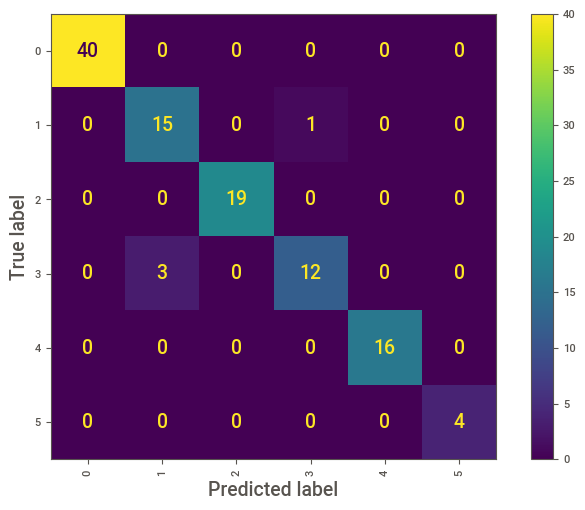

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_XGB_CLF, xticks_rotation='vertical')

## 9. Artificial Neural Networks Classifier

In [ ]:
# model creation
from sklearn.neural_network import MLPClassifier # MLP stands for Multi Layer Perceptron
ANN_CLF = MLPClassifier()
ANN_CLF.fit(x_train,y_train)

MLPClassifier()

In [ ]:
y_train_pred_ANN_CLF= ANN_CLF.predict(x_train)
y_test_pred_ANN_CLF= ANN_CLF.predict(x_test)

In [ ]:
# Evaluate ANN Classifier model:

print("ANN training set score:", accuracy_score(y_train, y_train_pred_ANN_CLF))
print("ANN test set score:", accuracy_score(y_test, y_test_pred_ANN_CLF))

ANN training set score: 0.99609375
ANN test set score: 0.9727272727272728


In [ ]:
# Classification Report of ANN Classifier Model
print(classification_report(y_test, y_test_pred_ANN_CLF, target_names=
                            ['psoriasis','seboreic_dermatitis','lichen_planus','pityriasis_rosea','cronic_dermatitis',
                             'pityriasis_rubra_pilaris']))

                          precision    recall  f1-score   support

               psoriasis       1.00      1.00      1.00        40
     seboreic_dermatitis       0.88      0.94      0.91        16
           lichen_planus       1.00      1.00      1.00        19
        pityriasis_rosea       0.93      0.87      0.90        15
       cronic_dermatitis       1.00      1.00      1.00        16
pityriasis_rubra_pilaris       1.00      1.00      1.00         4

                accuracy                           0.97       110
               macro avg       0.97      0.97      0.97       110
            weighted avg       0.97      0.97      0.97       110



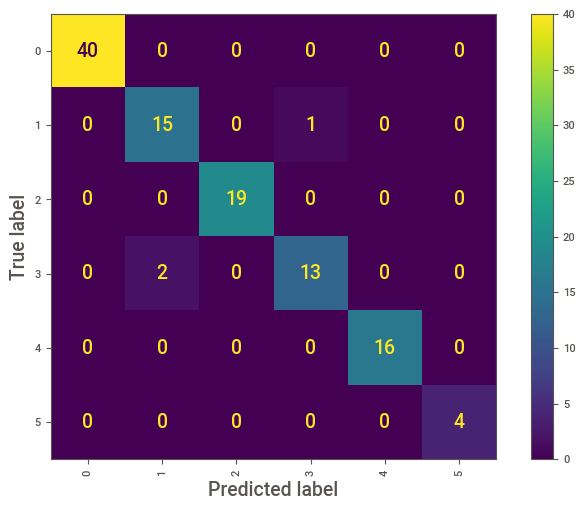

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_test_pred_ANN_CLF, xticks_rotation='vertical')

In [ ]:
Model_Comparison= pd.DataFrame({'Model':['Logistic Regressor ()',
                                         'KNN Classifier (Tuned)',
                                         'Support Vector Classifier(Tuned) ',
                                         'Decision Tree Classifier()',
                                         'Random Forest Classifier',
                                         'Multinomial Naive Bayes Classifier()',
                                         'Gradient Boosting Classifier()',
                                         'XG Boosting Classifier()',
                                         'ANN Classifier()'],

                                'Train Score':[accuracy_score(y_train, y_train_pred_Log_Reg),
                                               accuracy_score(y_train, y_train_pred_KNN_CLF_Tuned),
                                               accuracy_score(y_train, y_train_pred_SVM_CLF_Tuned),
                                               accuracy_score(y_train, y_train_pred_DTC),
                                               accuracy_score(y_train, y_train_pred_RFC),
                                               accuracy_score(y_train, y_train_pred_MNBC),
                                               accuracy_score(y_train,y_train_pred_GBC),
                                               accuracy_score(y_train,y_train_pred_XGB_CLF),
                                               accuracy_score(y_train, y_train_pred_ANN_CLF)],
                                'Test Score':[accuracy_score(y_test, y_test_pred_Log_Reg),
                                              accuracy_score(y_test, y_test_pred_KNN_CLF_Tuned),
                                              accuracy_score(y_test, y_test_pred_SVM_CLF_Tuned),
                                              accuracy_score(y_test, y_test_pred_DTC),
                                              accuracy_score(y_test, y_test_pred_RFC),
                                              accuracy_score(y_test, y_test_pred_MNBC),
                                              accuracy_score(y_test, y_test_pred_GBC),
                                              accuracy_score(y_test, y_test_pred_XGB_CLF),
                                              accuracy_score(y_test, y_test_pred_ANN_CLF)]})
Model_Comparison.index+=1
Model_Comparison

,Model,Train Score,Test Score
1,Logistic Regressor (),1.000000,0.972727
2,KNN Classifier (Tuned),1.000000,0.936364
3,Support Vector Classifier(Tuned),1.000000,0.963636
4,Decision Tree Classifier(),1.000000,0.972727
5,Random Forest Classifier,1.000000,0.963636
6,Multinomial Naive Bayes Classifier(),0.984375,0.981818
7,Gradient Boosting Classifier(),1.000000,0.963636
8,XG Boosting Classifier(),1.000000,0.963636
9,ANN Classifier(),0.996094,0.972727


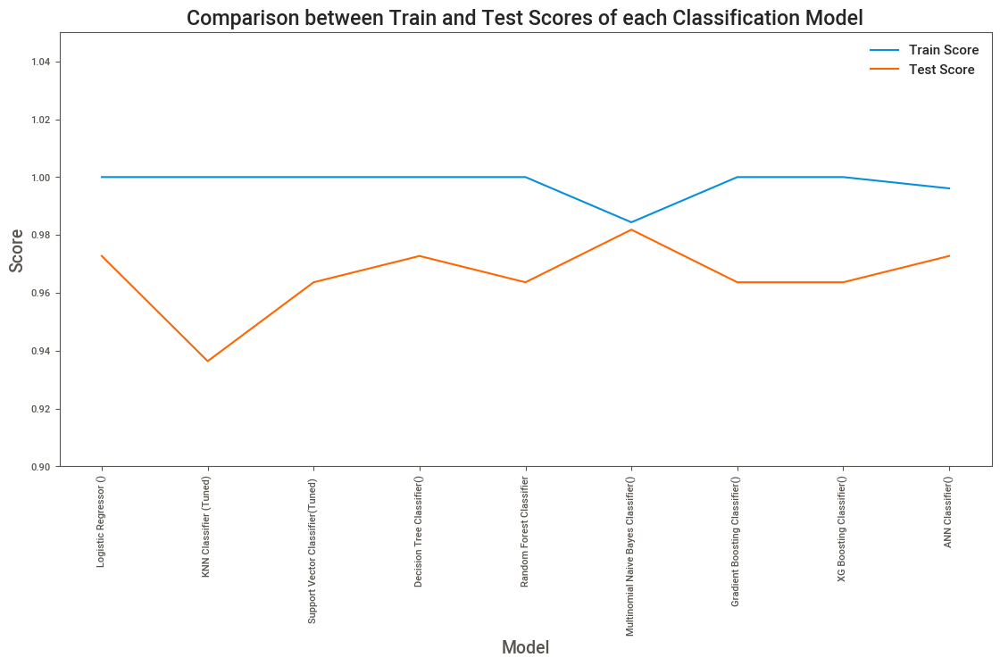

In [ ]:
import matplotlib.pyplot as plt

# Get the data from the dataframe
model_names = Model_Comparison['Model'].tolist()
train_scores = Model_Comparison['Train Score'].tolist()
test_scores = Model_Comparison['Test Score'].tolist()
plt.figure(figsize=(12,6))
# Plot the data
plt.plot(model_names, train_scores, label='Train Score', color='#0590DA')
plt.plot(model_names, test_scores, label='Test Score', color='#FF6600')
plt.legend()
plt.xticks(rotation=90)
plt.xlabel('Model')
plt.ylabel('Score')
plt.ylim(0.900, 1.05)
plt.title('Comparison between Train and Test Scores of each Classification Model')
plt.show()

In [ ]:
import plotly.graph_objects as go

fig = go.Figure(data=[
    go.Bar(name='Train Score', x= Model_Comparison['Model'], y= Model_Comparison['Train Score'],  text= Model_Comparison['Train Score'], texttemplate='%{text:.3}', textposition='outside', marker_color='#0590DA'),
    go.Bar(name='Test Score', x= Model_Comparison['Model'], y=Model_Comparison['Test Score'], text= Model_Comparison['Test Score'], texttemplate='%{text:.3}', textposition='outside', marker_color='#FF6600')])
# Change the bar mode
fig.update_layout(barmode='group', width=1000, height=600, margin=dict(l=50, r=50, b=50, t=60, pad=16))
fig.show()

## SUMMARY

* **The differential diagnosis of erythemato-squamous diseases is a real problem in dermatology. They all share the clinical features of erythema and scaling, with very little differences. The diseases in this group are psoriasis, seboreic dermatitis, lichen planus, pityriasis rosea, cronic dermatitis, and pityriasis rubra pilaris. Usually a biopsy is necessary for the diagnosis but unfortunately these diseases share many histopathological features as well. Another difficulty for the differential diagnosis is that a disease may show the features of another disease at the beginning stage and may have the characteristic features at the following stages. Patients were first evaluated clinically with 12 features. Afterwards, skin samples were taken for the evaluation of 22 histopathological features. The values of the histopathological features are determined by an analysis of the samples under a microscope.**


* **The Primary objective is to build a machine learning techniques, which can effectively differentiate skin disease classification.**

## METHODOLOGY FOLLOWED



* **The dataset contains  12 clinical features and 22 histopathological features, the feature family history has the value 1 if any of these diseases has been observed in the family, and 0 otherwise. The age feature simply represents the age of the patient. Every other feature (clinical and histopathological) was given a degree in the range of 0 to 3. Here, 0 indicates that the feature was not present, 3 indicates the largest amount possible, and 1, 2 indicate the relative intermediate values.**


* **Exploratory data analysis has been carried out on each features and their relationship with other features.**


* **The age feature had NAN values and zero values which was handled using the median of the age feature.**


* **Correlation of the features has been captured using heatmap.**

## INSIGHTS FROM EDA:

* **The distribution of 12 clinical features and 22 histopathological features in the dataset with 366 instances is depicted using histogram and KDE plot.**


* **Dieseases like Lichen_Planus, Cronic_Dermatitis,and Pityriasis_Rosea does not show any relation of tranfer within family members. Also, theses diseases can occurs in early ages till the age of 70 years is also as seen from the distribution.**


* **Diseases like Psoriasis and Pityriasis_rubra_pilaris shows strong relation of transfer from family and disease Seboreic_Dermatitis too shows a some relation of transfer within family members.**


* **Disease like Pityriasis_rubra_pilaris shows its presence in early ages and till the age of 15 to 20 years only.**


* **Diseases like Psoriasis and Seboreic_Dermatitis shows its presence in early ages and till the age of 70 years.**


* **The Disease / target class count plot showed imbalanced values between diffrent classes which was balanced using combination of SMOTE and edited nearest neighbor technique.**


* **Heatmap is used to find the correlation between the features too.**

## INSIGHTS FROM CLASSIFICATION MODELS:

### Model-1: Logistic Classifier
* **For the tuned Logistic classifer model, the  accuracy score for train and test data were 1 and 0.972 respectively.**

### Model-2: KNN Classifier
* **For the tuned KNN classifer model, the  accuracy score for train and test data were 1 and 0.936 respectively.**

### Model-3: Support Vector Classifier
* **For Support Vector classifer model, the  accuracy score for train and test data were 1 and 0.963 respectively.**

### Model-4: Desicion Tree Classifier
* **For Desicion Tree classifer model, the  accuracy score for train and test data were 1 and 0.972 respectively.**

### Model-5: Random Forest Classifier
* **For Random Forest classifer model, the  accuracy score for train and test data were 1 and 0.963 respectively.**

### Model-6: Multinomial Naive Bayes Classifier
* **For Random Forest classifer model, the  accuracy score for train and test data were 0.984 and 0.981 respectively.**

### Model-7: Gradient Boost Classifier
* **For Gradient Boost classifer model, the  accuracy score for train and test data were 1 and 0.963 respectively.**

### Model-8: XGB Classifier
* **For XGB classifer model, the accuracy score for train and test data were 1 and 0.963 respectively.**

### Model-9: KNN Classifier
* **For KNN classifier model, the accuracy score for train and test data were 1 and 0.963 respectively.**

## CONCLUSION:

* **Patients were first evaluated clinically with 12 features. Afterwards, skin samples were taken for the evaluation of 22 histopathological features.**


* **From EDA, skin diseases Psoriasis and Pityriasis_rubra_pilaris shows strong relation of transfer from family members and disease Seboreic_Dermatitis too shows a some relation of transfer within family members. Skin disease like Pityriasis_rubra_pilaris shows its presence in early ages till the age of 15 to 20 years only. Skin diseases Psoriasis and Seboreic_Dermatitis shows its presence in early ages till the age of 70 years.**


* **As observed during the t-SNE analysis, the class features '1', '3', and '4' exhibited overlapping patterns. This observation aligns with the findings from the confusion matrix and classification report, where it becomes evident that the model is encountering challenges in accurately classifying instances belonging to these classes. The model's performance in these specific classes is reflected in the confusion matrix and reflected in the metrics reported in the classification report.**


* **The 9 machine learning models have been studied and tuned and evaluated for acheiving better performance of the model using various metrices and accuracy scores.**


* **The Multinominal Naive Bayes classifier Model has given a better accuracy Score and F1 Score compared to other classifier models and hence recommend to use Multinominal Naive Bayes classifier Model in order for the doctors to identify the skin diseases of the patient at the earliest.**

## CHALLENGES FACED:

* **The age feature had NAN and zero values which were replaced using the median of the age feature.**

* **Various classifier models were studied and evaluated using accuracy score, classification report and confusion matrix.**

* T**he model with highest accuracy score and F1 Score was obtained in Multinominal Naive Bayes classifier and hence will be the deciding factor.**